# Divergence

In [1]:
from scipy.stats import binom, uniform, norm
from scipy.signal import unit_impulse
import matplotlib.pyplot as plt
import numpy as np

## KL, JS, WD

KL дивергенция является некоторой мерой расстояния, отражающей разницу между двумя вероятностными распределениями. KL дивергенция, однако, не является симметричной, а потому не соответствует формальному математическому определению расстояния. Пусть P и Q - распределения вероятность дискретной случайной величины x, тогда дивергенция Кульбака-Лейблера определяется как:
$$\text{KL}(P||Q)=\sum p_i(x)\log \left(\frac{p_i(x)}{q_i(x)}\right)$$

In [2]:
# we need to make sure that we don’t include any probabilities equal to 0
# as the log of 0 is negative infinity
# from scipy.special import kl_div as kl_divergence
def kl_divergence(p, q):
    q = q[p != 0]
    p = p[p != 0]
    # return np.sum(np.where(p != 0, p * np.log(p / q), 0))
    return np.sum(p * np.log(p / q))

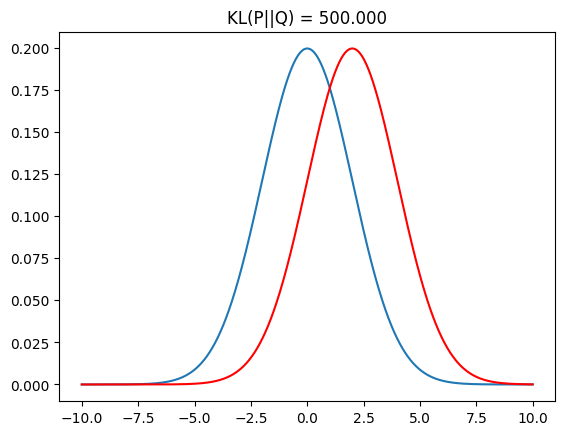

In [3]:
x = np.arange(-10, 10, 0.001)
p = norm.pdf(x, 0, 2)
q = norm.pdf(x, 2, 2)
plt.title(f'KL(P||Q) = {kl_divergence(p, q):.3f}')
plt.plot(x, p)
plt.plot(x, q, c='red');

Если мы ещё сильнее увеличим разницу между мат. ожиданиями и дисперсиями, то KL дивергенция должна существенно увеличится, т.к. распределенния стали различаться ещё сильнее.


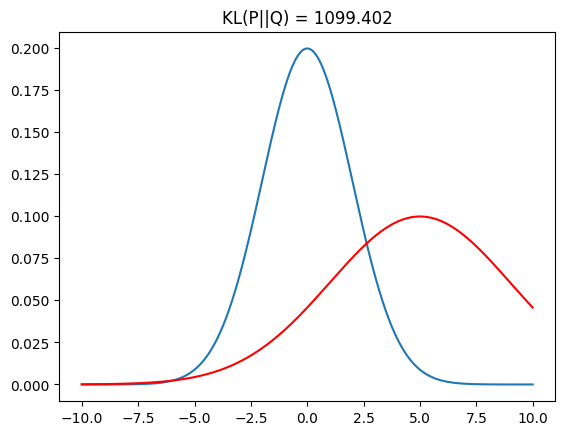

In [4]:
q = norm.pdf(x, 5, 4)
plt.title(f'KL(P||Q) = {kl_divergence(p, q):.3f}')
plt.plot(x, p)
plt.plot(x, q, c='red');

In [5]:
# we may also use scipy implementation
from scipy.special import kl_div, rel_entr
np.sum(rel_entr(p, q))

1099.4021277960894

 Теперь мы реализуем метод, вычисляющий дивергенцию Йенсена-Шенона $JSD(P\|Q) = \frac{1}{2} (KL(P\|M)+ KL(Q\|M))$, где $M=\frac{1}{2}(P+Q)$.

In [6]:
def js_divergence(p, q):
    m = (p + q) / 2
    return (kl_divergence(p, m) + kl_divergence(q, m)) / 2

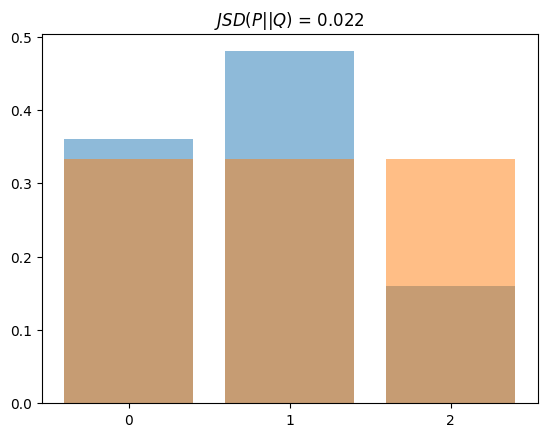

In [7]:
a = binom(2, 0.4)
x = np.arange(3)
p = a.pmf(x)
q = 1 / len(x) * np.ones_like(x)
plt.title(f'$JSD(P||Q)$ = {js_divergence(p, q):.3f}')
plt.bar(x, p, alpha = 0.5, tick_label=x)
plt.bar(x, q, alpha = 0.5, tick_label=x);

In [8]:
from scipy.stats import wasserstein_distance

Расстояние Вассерштейна - это мера расстояния между двумя вероятностными распределениями. Его также называют earth mover's distance (расстояние переносчика земли, сокращенно EM distance или EMD), т.к. можно интерпретировать эту меру как минимальная энергия, которую нужно потратить, чтобы превратить одну кучу земли в другую (кучи земли - плотности распределения). Чем больше нужно "перенести" земли и чем на большее расстояние, тем выше цена "переноса".

## Почему расстояние вассерштайна лучшем, чем KL дивергенция или JS дивергенция.

Даже когда два распределения обладают непересекающимися областями определения расстояние Вассерштейна все равно является осмысленным: чем ближе наши распределеня в интуитивном смысле (ближе графики плотностей) тем меньше расстояние.

В статье WGAN был рассмотрен небольшой пример такого типа:

Пусть имеются два распределения, P и Q:
$$\forall (x, y) \in P, x = 0 \text{ и } y \sim U(0, 1)$$
$$\forall (x, y) \in Q, x = \theta, -19 \leq \theta \leq 19 \text{ и } y \sim U(0, 1)$$
Тогда чем ближе $\theta$ к нулю, тем меньше расстояние $W(P||Q)$, в то время как JS и KL дивергенции не являются неприрывными и не обладают осмысленными градентыми.

<ipython-input-2-8537155d431a>:8: RuntimeWarning: divide by zero encountered in divide
  return np.sum(p * np.log(p / q))


KL: [ 0. inf]
JS: [0.    0.693]


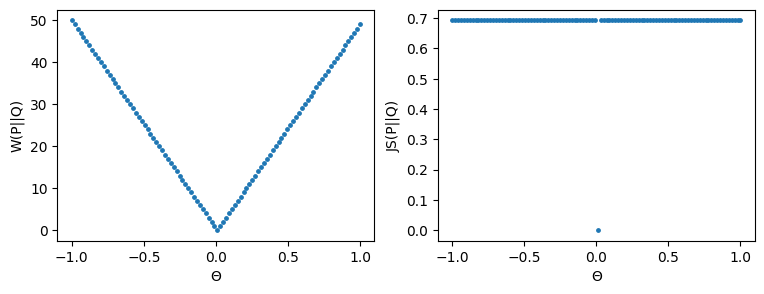

In [9]:
n = 100
thetas = np.linspace(-1, 1, n)
kl = []
js = []
emd = []
for theta in thetas:
    p = unit_impulse(n, idx=n // 2)
    q = unit_impulse(n, idx=round((theta+1) * (n-1) / 2))
    kl.append(kl_divergence(p, q))
    js.append(js_divergence(p, q))
    emd.append(wasserstein_distance([np.argmax(p)], [np.argmax(q)]))

print(f"KL: {np.round(np.unique(kl), 3)}")
print(f"JS: {np.round(np.unique(js), 3)}")

_, axes = plt.subplots(ncols=2, figsize=(9, 3))
axes[0].scatter(thetas, emd, s=6)
axes[0].set_ylabel("W(P||Q)")
axes[0].set_xlabel("Θ")
axes[1].scatter(thetas, js, s=6)
axes[1].set_ylabel("JS(P||Q)")
axes[1].set_xlabel("Θ")
plt.show()

KL равна бесконечности, когда $\theta \not = 0$ (непересекающиеся областя определения). График JS диввергенции имеет разрыв в точке 0, поэтому недифференцируем. Только расстояние вассерштейна имеет гладкий график, что очень важно для стабильности в процессе обучения методом градиентного спуска.

# DCGAN туториал

## Что такое DCGAN?

DCGAN это прямое расширение модели GAN, с которой мы познакомились, но он использует сверточные и сверточные-траспонированные слои в дискриминаторе и генераторе, соответственно. Такая модель была описана в работе [Unsupervised Representation Learning With Deep Convolutional Generative Adversarial Networks](https://arxiv.org/pdf/1511.06434.pdf).

Дискриминатор состоит из [сверток](https://pytorch.org/docs/stable/nn.html#torch.nn.Conv2d) с шагом, [батч нормализаций](https://pytorch.org/docs/stable/nn.html#torch.nn.BatchNorm2d), и [LeakyReLU активаций](https://pytorch.org/docs/stable/nn.html#torch.nn.LeakyReLU). Размерность входного изображения равна 3x64x64, а на выходе скаляр - веростность, что входное изображение было выбрано из реальных данных.

Генератор состоит из [сверточных-транспонированных](https://pytorch.org/docs/stable/nn.html#torch.nn.ConvTranspose2d) слоем, батч нормализаций, и
[ReLU](https://pytorch.org/docs/stable/nn.html#relu) активаций. На входе имеем латентный вектор, $\mathbb{z}$, засемпленный из стандартного нормального распределения, а на выходе получаем RGB изображение с размерами 3x64x64. Свертночные-транспонирвоанные слои позволяют трансформировать латентный вектор в представление с размерами, соответсвующим изображениям. В статье авторы также предлагают некоторые подсказки о том, как инициализировать оптимизатор, рассчитывать функцию потерь и инициализировать веса модели. Некоторые из них мы рассмотрим далее.




In [10]:
from __future__ import print_function
import argparse
import os
import pickle
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils


import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seed for reproducibility
manualSeed = 42
#manualSeed = random.randint(1, 10000) # use if you want new results
random.seed(manualSeed)
torch.manual_seed(manualSeed)

In [11]:
# Utility function to plot results
def tensor_to_image(tensor):
    if len(tensor.shape) == 4:
        tensor = tensor[0]
    tensor = ((tensor + 1) / 2).clamp(0, 1)
    return np.transpose((255 * tensor.cpu().detach()).numpy().astype(np.uint8), axes=(1, 2, 0))

## Inputs

Смысл некоторых параметров:

-  **dataroot** - путь к порню папки с датасетом.
-  **workers** - число threads для DataLoader
-  **batch_size** - размер батча, используемый при обучении.
-  **image_size** - пространственные (spatial) размеры изображений. Для использования другого размера необходимо изменить структуру D и G [см. тут](https://github.com/pytorch/examples/issues/70)
-  **nc** - число входных каналов (для RGB изображений 3)
-  **nz** - размер латентного вектора
-  **ngf** - определяет как много каналов используется в слоях генератора
-  **ndf** - определяет как много каналов используется в слоях дискриминатора
-  **num_epochs** - число эпох для обучения
-  **lr** - learning rate. В соответствии с DCGAN статье выбран 0.0002
-  **beta1** - beta1 гиперпараметр для Adam. В соответствии с DCGAN выбран 0.5
-  **ngpu** - число доступных GPU. При 0 будет использован CPU, инче будет использовано столкьо GPU, сколько указано.



In [12]:
dataroot = "./data/"
workers = 2
batch_size = 128
image_size = 64
nc = 3
nz = 100
ngf = 64
ndf = 64
num_epochs = 20
lr = 0.0002
beta1 = 0.5
ngpu = 1

## Data

Мы будем использовать [Celeb-A Faces датасет](http://mmlab.ie.cuhk.edu.hk/projects/CelebA.html). Датасет будет загружен как файл *img_align_celeba.zip*. После загрузки создайте папку *data* и извлеките zip файл в неё. Установити значение переменной *dataroot* в правильный путь до папки *data*. Структура датасета должна выглядеть так.
```
   /path/to/celeba
       -> img_align_celeba  
           -> 003764.jpg
           -> 029089.jpg
           -> 054414.jpg
           -> 079739.jpg
              ...
```

In [13]:
# !wget https://cseweb.ucsd.edu/~weijian/static/datasets/celeba/img_align_celeba.zip

In [14]:
# !unzip img_align_celeba.zip -d data

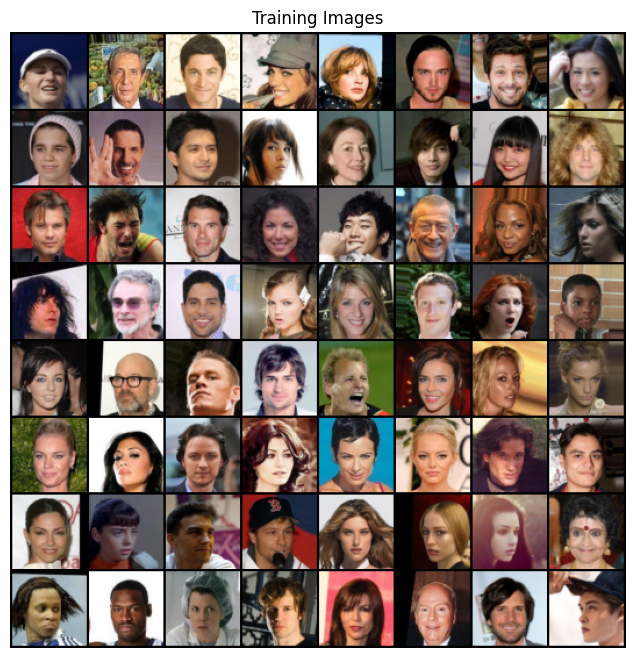

In [15]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

## Weight Initialization

В статье DCGAN, авторы отмечают, что все веса модели инициализированы из нормального распределения со средним=0 и стандартным отклонением=0.02.

Метод ``weights_init`` получает инициализированную модель и реинициализирует её все сверточные слои и батч нормализации по указанному правилу.

Эта функция применяется к модели сразу после инициализации.




In [16]:
# custom weights initialization called on netG and netD
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

## Generator

Генератор, $G$, сконструирован так, чтобы маппить вектор из латентного пространства в пространство изображений. Таким образом генератор создает RGB изображения с таким же размером, как изображения в обучающем датасете (3x64x64). На практике это достигается применением ряда сверточных-транспонированных слоев с шагом. Каждый слой сопровождается 2d батч нормализацией и relu активацией. Выход генератора проходит через tanh функцию, чтобы вернуть данные в интервал $[-1,1]$.

Использование 2d батч нормализаций является очень важным вкладом работы DCGAN. Эти слои помогают достичь более стабильного тока градиентов в процессе обучения. Ниже показано изображением генератора из работы DCGAN.

![Генератор](https://pytorch.org/tutorials/_images/dcgan_generator.png)




In [17]:
# Generator Code
class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

Теперь мы можешь создать генератор и применить к нему нашу функцию инициализации весов ``weights_init``. Обратите внимание как устроен генератор по полученному принту.




In [18]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.02.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


## Discriminator

Как упоминалось, дискриминатор, $D$, это бинарный классификатор, который по входному изображению предсказывает скаляр - вероятность того, что это изображение взято из реальных данных. В нашем случае на входе $D$ имеет изображение размера 3x64x64, пропускает его через ряд сверточных слоев, батч нормализаций и LeakyReLU активаций. В конце результат сети проходит через Sigmoid функцию.

Авторы DCGAN отмечают, что использование сверток с шагом более эффективно, чем применение пулинг слоев, потому что это позволяет нейросети выучить пулинг функции самостоятельно. Батч нормализации и LeakyReLU улучшают ток градиентов при обучении, что очень важно как для $D$, так и для $G$.




In [19]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

Теперь как и для генератор мы создаем модель и применяем нашу функцию инициализации весов ``weights_init``.




In [20]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace=True)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace=True)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace=True)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace=True)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


## Loss Functions and Optimizers



In [21]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1.
fake_label = 0.

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=lr, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

## Training

**Часть 1 - обучение дискриминатора**

Задача дискриминатор - максимизация вероятности корректной классификации входного изображения. В оригинально работе это предложено осуществлять с помощью градиентного подъема, а максимизируемый функционал имеет вид: $\log{D(x)}+\log{(1-D(G(z)))}$. Мы можем реализовать это с помощью прогона двух батчей:
- Берем батч реальных данных и пропускаем через дискриминатор, считаем функцию потерь $\log{D(x)}$ и градиенты с помощью backward
- Берем батчь из сгенерированных изображений и также прогоняем через дискриминатор, считаем функцию потерь $\log{1-D(G(z))}$ и считаем градиенты с помощью backward
- Выполняем шаг оптимизатора.

**Часть 2 - обучение генератора**

Генератор, напротив, пытается минимизировать функционал дискриминатора. Он может повлияеть только на член $\log{(1-D(G(z)))}$. Это эквивалентно максимизации $\log{D(G(z))}$, но вторая формула имеет гораздо большие градиенты, особенно на ранних этапах, когда генератор ещё слабо обучен.


Это можно реализовать в коде следующим образом: передаем дискриминатору сгенерированный батч и считаем функцию потерь, передавая лейблы "реальные изображения" (т.е. по сути неправильные лейблы) нашей функции потерь. Считаем градиенты и обновляем веса как обычно.

Использование неверных лейблов может казаться странным, но это просто помогает нам использовать $\log{(x)}$ вместо $\log{(1-x)}$, чего мы и добиваемся.

По завершении каждой эпохи мы будем вычислять некоторые статистики. Мы будем генерировать изображения по fixed_noise батсчу дли визуализации и вычислять следующие значения.
-  **Loss_D** - loss дискриминатора: сумма лоссов для всех батчей $log(D(x)) + log(1 - D(G(z)))$.
-  **Loss_G** - loss генератора: $log(D(G(z)))$
-  **D(x)** - средний выход (внутри батча) дискриминатора на всех реальных батчах.
-  **D(G(z))** - средний выход дискриминатора на всех сгенерированных батчах.
   Первое число - перед обновлением D, второе число - после обновления D.




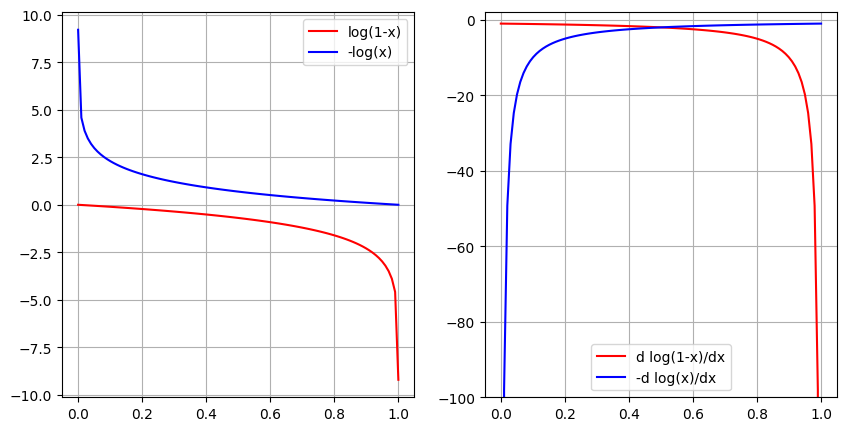

In [22]:
x = np.linspace(1e-4, 1-1e-4, 100)
_, axes = plt.subplots(ncols=2, figsize=(10, 5))
axes[0].plot(x, np.log(1-x), c='r', label='log(1-x)')
axes[0].plot(x, -np.log(x), c='b', label='-log(x)')
axes[0].legend()
axes[0].grid()

axes[1].plot(x, -1 / (1-x), c='r', label='d log(1-x)/dx')
axes[1].plot(x, -1 / x, c='b', label='-d log(x)/dx')
axes[1].set_ylim(-100, 2)
axes[1].legend()
axes[1].grid()

In [23]:
# Training Loop

# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0

print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch, accumulated (summed) with previous gradients
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Compute error of D as sum over the fake and the real batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1

Starting Training Loop...
[0/20][0/1583]	Loss_D: 1.8577	Loss_G: 5.4036	D(x): 0.6031	D(G(z)): 0.6515 / 0.0078
[0/20][50/1583]	Loss_D: 0.1833	Loss_G: 8.5926	D(x): 0.9616	D(G(z)): 0.1019 / 0.0005
[0/20][100/1583]	Loss_D: 1.0348	Loss_G: 7.5558	D(x): 0.6175	D(G(z)): 0.0048 / 0.0030
[0/20][150/1583]	Loss_D: 0.3300	Loss_G: 3.4665	D(x): 0.8158	D(G(z)): 0.0515 / 0.0591
[0/20][200/1583]	Loss_D: 0.4291	Loss_G: 3.7856	D(x): 0.7415	D(G(z)): 0.0296 / 0.0447
[0/20][250/1583]	Loss_D: 0.8612	Loss_G: 6.6460	D(x): 0.7893	D(G(z)): 0.2929 / 0.0021
[0/20][300/1583]	Loss_D: 0.5329	Loss_G: 3.6139	D(x): 0.7858	D(G(z)): 0.2033 / 0.0490
[0/20][350/1583]	Loss_D: 1.1603	Loss_G: 7.7915	D(x): 0.8367	D(G(z)): 0.5046 / 0.0030
[0/20][400/1583]	Loss_D: 0.6822	Loss_G: 3.5242	D(x): 0.7839	D(G(z)): 0.2820 / 0.0438
[0/20][450/1583]	Loss_D: 0.3956	Loss_G: 3.6518	D(x): 0.7936	D(G(z)): 0.0929 / 0.0453
[0/20][500/1583]	Loss_D: 0.3852	Loss_G: 5.0762	D(x): 0.8385	D(G(z)): 0.1120 / 0.0130
[0/20][550/1583]	Loss_D: 0.5417	Loss_G: 5.

In [24]:
import os.path as osp
root = osp.join("/content/drive", "MyDrive", "URFU_CV", "DCGAN")
torch.save(netD, osp.join(root, f'netD_{num_epochs}_epoch.pth'))
torch.save(netG, osp.join(root, f'netG_{num_epochs}_epoch.pth'))
with open(osp.join(root, f'img_list_{num_epochs}.pickle'), 'wb') as f:
    pickle.dump(img_list, f)

## Результаты

Наконец, давайте посмотрим что мы получили. Тут мы увидим
- Как значения функций потерь менялись для G и D
- Визуализируем как менялся выход генератора в процессе обучения на фиксированном fixed_noise батче
- Сравним реальные и сгенерированные данные визуально

**Loss vs номер итерации**


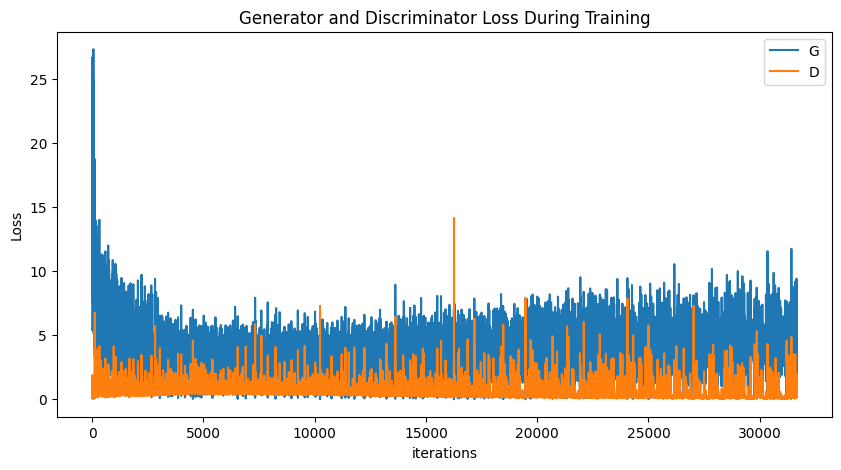

In [25]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

**Визуализация прогресса генератора**
Попробуем получить анимацию того, как менялись полученные генератором изображения на батче fixed_noise в процессе обучения.




In [27]:
# with open('img_list_10.pickle', 'rb') as f:
#     img_list = pickle.load(f)

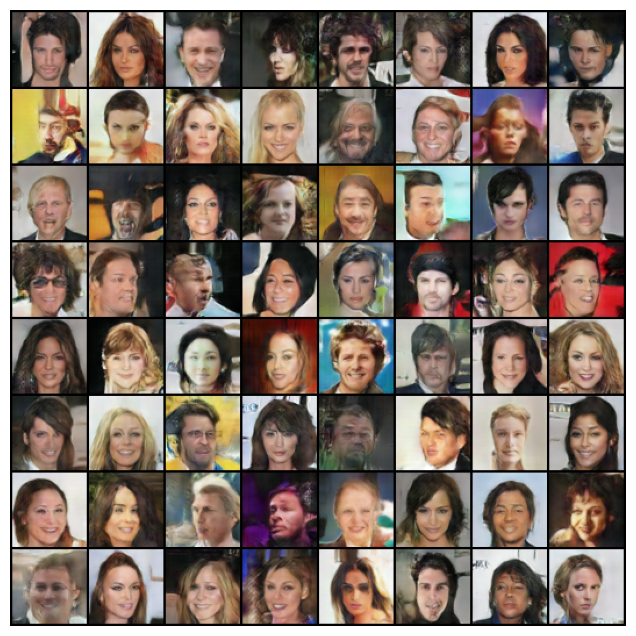

In [26]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

**Реальные изображения vs.Фейковые изображения**




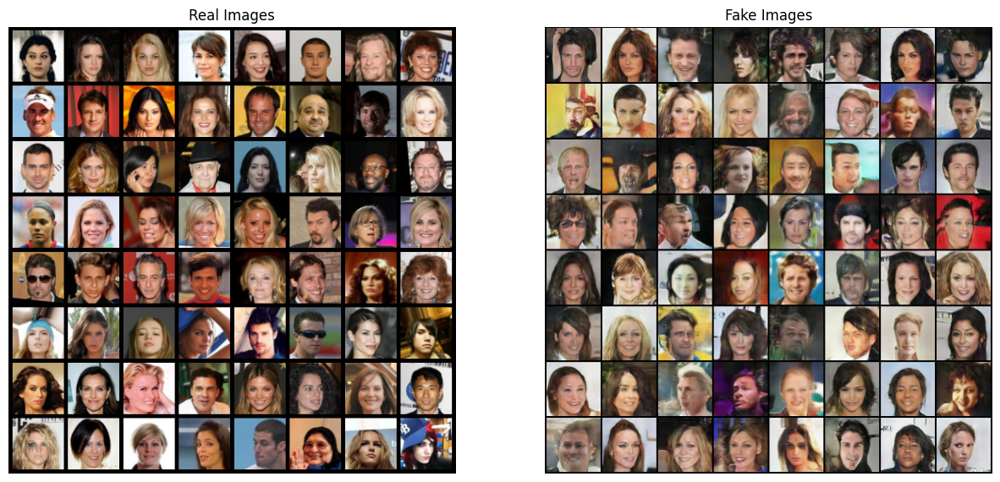

In [27]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(dataloader))

# Plot the real images
plt.figure(figsize=(15,15))
plt.subplot(1,2,1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=5, normalize=True).cpu(),(1,2,0)))

# Plot the fake images from the last epoch
plt.subplot(1,2,2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(np.transpose(img_list[-1],(1,2,0)))
plt.show()

## Latent Space алгебра

Выберем два случайных шума и будем двигаться между ними с помощью линейной интерполяции. В каждой точке получаем выход генератора и визулизируем его.

In [29]:
netG = torch.load(osp.join(root, 'netG_20_epoch.pth'))
netG.eval()

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace=True)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace=True)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace=True)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace=True)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)

In [32]:
with torch.no_grad():
    z = torch.randn([2, nz,1,1]).to(device)
    initial_images = netG(z)

    z = torch.stack([с * z[1] + (1 - с) * z[0] for с in torch.arange(0, 1.00, 0.125)])
    interp_images = netG(z)

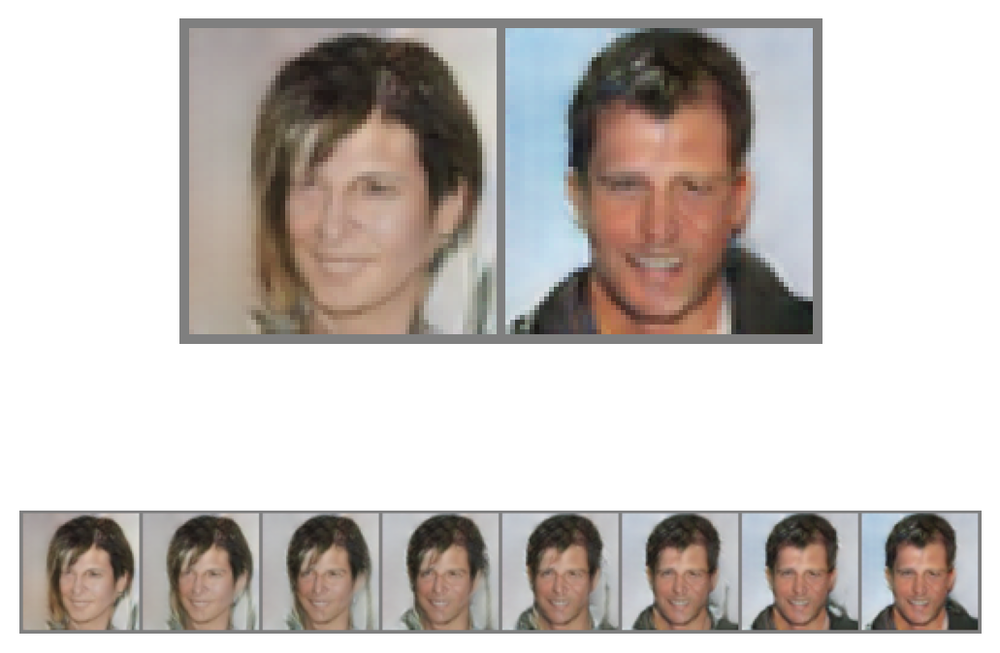

In [33]:
_, axs = plt.subplots(2, 1, dpi=200)
for ax in axs: ax.axis('off')

axs[0].imshow(tensor_to_image(vutils.make_grid(initial_images, nrow=6)))
axs[1].imshow(tensor_to_image(vutils.make_grid(interp_images, nrow=len(z))))